In [1]:
import os
import numpy as np
import cv2
from matplotlib import pyplot as plt

### Wczytanie 12 obrazów

In [2]:
paths = [r"sample_images\case0029",
         r"sample_images\case0217",
         r"sample_images\case0235"]

In [3]:
def load_images_from_folder(folder):
    images = []
    for filename in os.listdir(folder):
        img = cv2.imread(os.path.join(folder,filename))
        if img is not None:
            images.append(img)
    return images

In [4]:
all_images = []
for path in paths:
    all_images.append(load_images_from_folder(path))

In [5]:
all_images = [item for sublist in all_images for item in sublist]

In [6]:
len(all_images)

12

In [7]:
def show_images(img_list, rows, cols):
    fig,axes = plt.subplots(nrows = rows, ncols = cols, figsize=(50,50))

    for ax in axes.flatten():
        ax.axis('off')

    for j in range(3):    
        for i in range(4):
            axes[j,i].imshow(img_list[j*4 + i])

    plt.show()

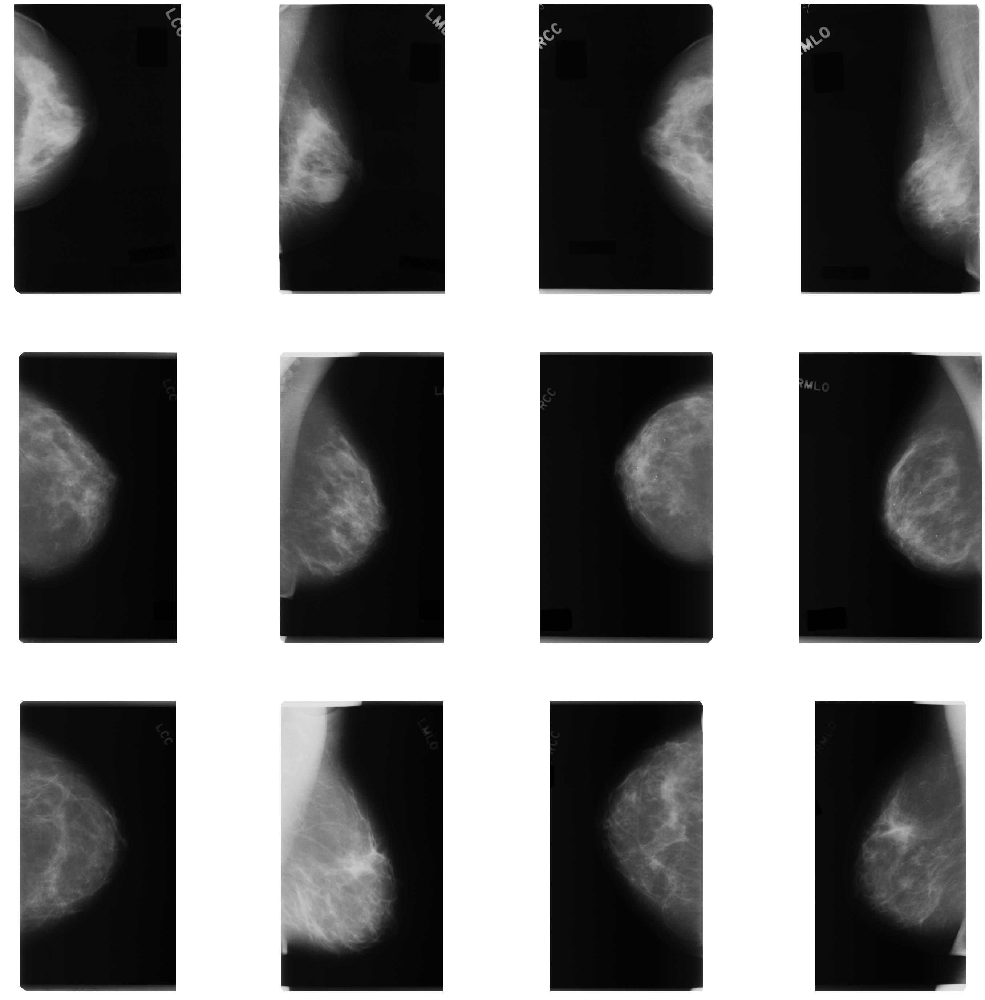

In [8]:
show_images(all_images,3,4)

### Zamiana na czarno-białe

In [9]:
all_grey_images = []
for img in all_images:
    all_grey_images.append(cv2.cvtColor(img, cv2.COLOR_BGR2GRAY))

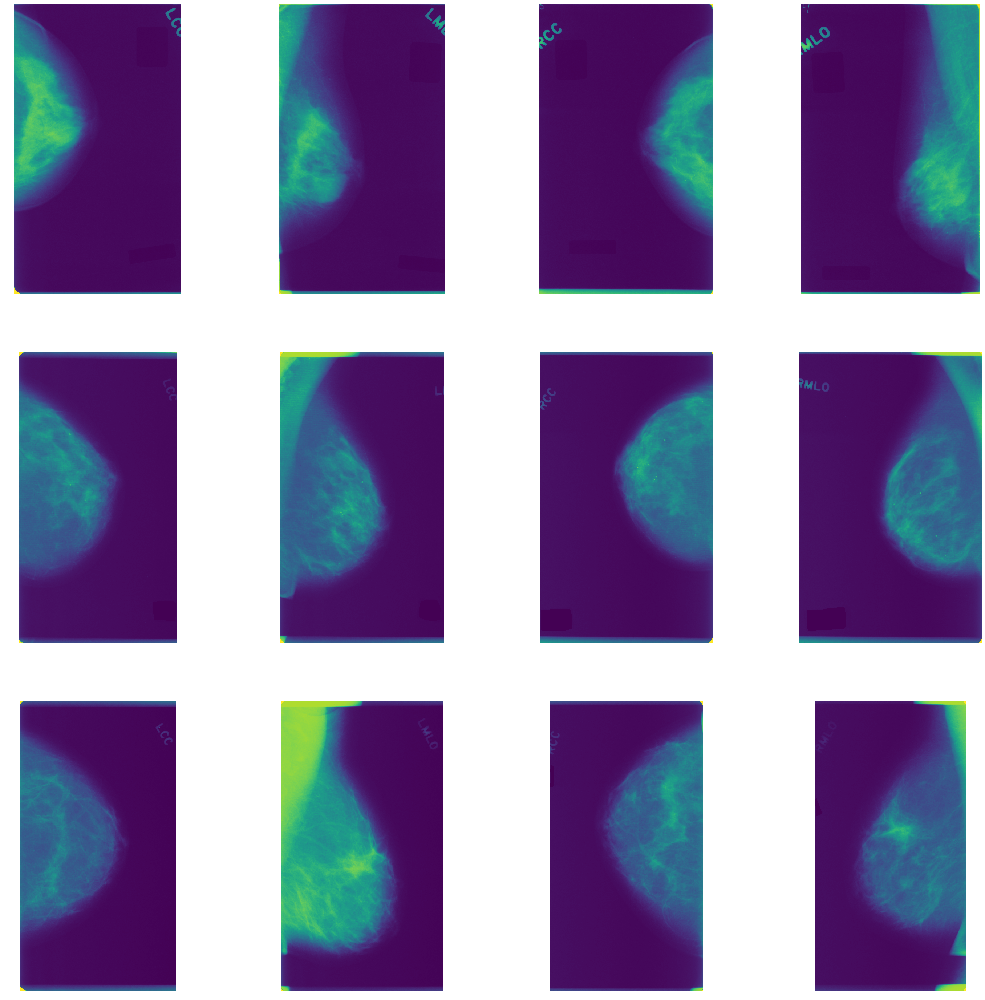

In [10]:
show_images(all_grey_images,3,4)

### Przygotowanie listy do przechowywania obrazów i informacji o nich

In [141]:
all_images_with_info = []

class ImageInfo():
    
    def __init__(self,img_id, raw_image):
        self.img_id = img_id
        self.raw_image = raw_image
        self.side = None
        self.projection = None
        self.first_ROI = None
        self.final_ROI = None

In [142]:
for i, img in zip(range(len(all_grey_images)), all_grey_images):
    all_images_with_info.append(ImageInfo(i,img))

## 1. Sprawdzanie rodzaju obrazu: L/P, MLO/CC

### 1.1. Sprawdzenie: obraz L czy P

In [13]:
# pętla po wszystkich obrazkach : 

L_P_sides = []

for img in all_grey_images:
    
    # sprawdzenie lewej strony
    if img[int(img.shape[0]/2), 3] < 40:
        L_P_sides.append("right")
        print("this is right")
    # sprawdzenie prawej strony
    elif img[int(img.shape[0]/2), img.shape[1]-3] < 40:
        L_P_sides.append("left")
        print("this is left")

grey_images_with_info['side'] = L_P_sides

this is left
this is left
this is right
this is right
this is left
this is left
this is right
this is right
this is left
this is left
this is right
this is right


In [145]:
for i, side in zip(range(len(all_images_with_info)), L_P_sides):
    all_images_with_info[i].side = side

### 1.2. Sprawdzenie: obraz CC czy MLO

In [16]:
# pętla po wszystkich: 

CC_or_MLO = []

for img,i in zip(all_grey_images, range(len(all_grey_images))):
    
    # check side
    if grey_images_with_info['side'][i] == 'left':
        # number of almost black pixels
        n_b = len(img[:, 15][np.where(img[:, 15] < 40)])
        print("number of almost black pictures: " + str(n_b))
        if n_b < 0.2 * img.shape[0]:
            CC_or_MLO.append("MLO")
            print("MLO")
            print("-----")
        else:
            CC_or_MLO.append("CC")
            print("CC")
            print("-----")
    else:
        # number of almost black pixels
        n_b = len(img[:, -15][np.where(img[:, -15] < 40)])
        print("number of almost black pictures: " + str(n_b))
        if n_b < 0.2 * img.shape[0]:
            CC_or_MLO.append("MLO")
            print("MLO")
            print("-----")
        else:
            CC_or_MLO.append("CC")
            print("CC")
            print("-----")

number of almost black pictures: 1300
CC
-----
number of almost black pictures: 302
MLO
-----
number of almost black pictures: 1152
CC
-----
number of almost black pictures: 0
MLO
-----
number of almost black pictures: 1795
CC
-----
number of almost black pictures: 788
MLO
-----
number of almost black pictures: 1842
CC
-----
number of almost black pictures: 634
MLO
-----
number of almost black pictures: 1398
CC
-----
number of almost black pictures: 219
MLO
-----
number of almost black pictures: 516
MLO
-----
number of almost black pictures: 0
MLO
-----


In [146]:
for i, projection in zip(range(len(all_images_with_info)), CC_or_MLO):
    all_images_with_info[i].projection = projection

## 2. Wybranie największego konturu, obcięcie brzegów obrazu i usunięcie małych fragmentów

Zmiana obrazu na binarny służy w tym przypadku przede wszystkim temu, aby zobaczyć jak zastosowany próg potraktował rozmyte brzegi sutka i czy nie uciął części obszaru który jest interesujący. Na poniższych żółto-fioletowych obrazach widać, że zdecydowana większość pikseli obszaru zainteresowania jest rzeczywiście zaznaczona (nie ma bardzo poszarpanych brzegów i powycinanych plam).

In [21]:
threshold = 12

In [32]:
y=0
x=0
u=200    # ustalenie
d=200    # krawędzi
l=200    # do obcięcia
r=200

In [35]:
all_cropped_gray_images = []
all_rois = []

for img in all_grey_images:
    _, binary_img = cv2.threshold(img, threshold, 255, cv2.THRESH_BINARY_INV)
    inverted_img = 255 - binary_img
    cropped_img = inverted_img[u:inverted_img.shape[0]-d, l:inverted_img.shape[1]]
    
    # find contours
    cnts = cv2.findContours(cropped_img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]
    
    # find biggest object on image
    mx = (0,0,0,0)      # biggest bounding box so far
    mx_area = 0
    for cont in cnts:
        x,y,w,h = cv2.boundingRect(cont)
        area = w*h
        if area > mx_area:
            mx = x,y,w,h
            mx_area = area
    x,y,w,h = mx

    # Output
    roi = img[y:y+h,x:x+w]
    binary_roi = cropped_img[y:y+h,x:x+w]
    
    all_cropped_gray_images.append(binary_roi)
    all_rois.append(roi)

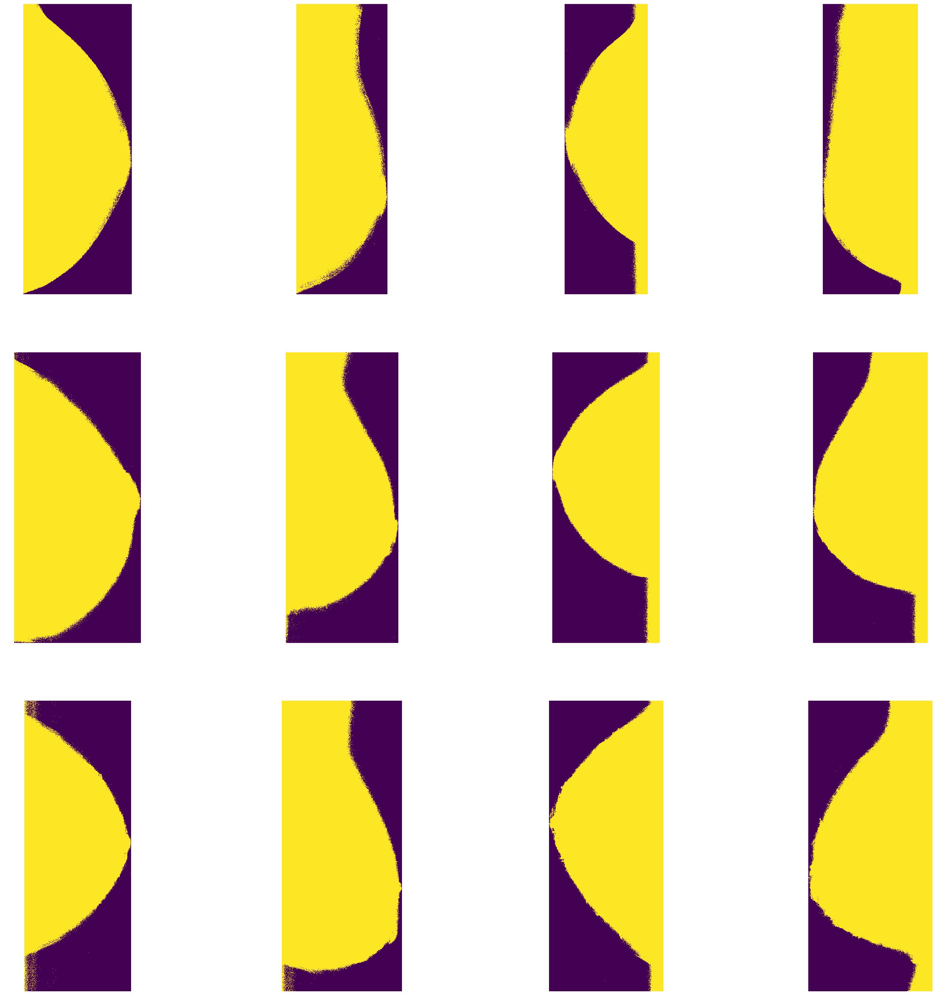

In [36]:
show_images(all_cropped_gray_images,3,4)

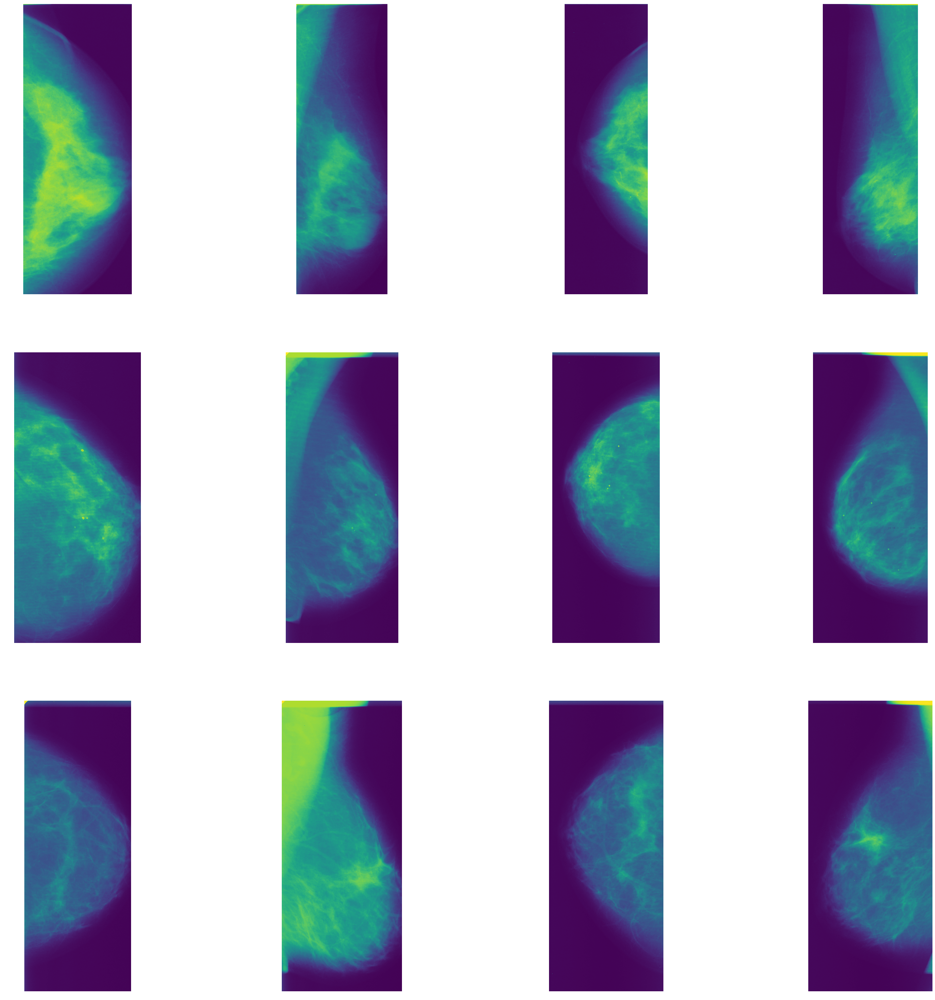

In [122]:
show_images(all_rois,3,4)

In [147]:
for i, roi in zip(range(len(all_images_with_info)), all_rois):
    all_images_with_info[i].first_ROI = roi

## 3. Wycinanie mięśnia z obrazów MLO

### 3.1. Próba znalezienia konturu mięśnia

In [60]:
failed_MLO_images = []

In [63]:
for i in range(1, len(all_rois), 2):
    ret, thresh = cv2.threshold(all_rois[i], 60, 255, 0)
    contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    img_with_contours = all_rois[i].copy()
    image = cv2.drawContours(img_with_contours, contours, -1, (220,0,0), 2)
    failed_MLO_images.append(image)

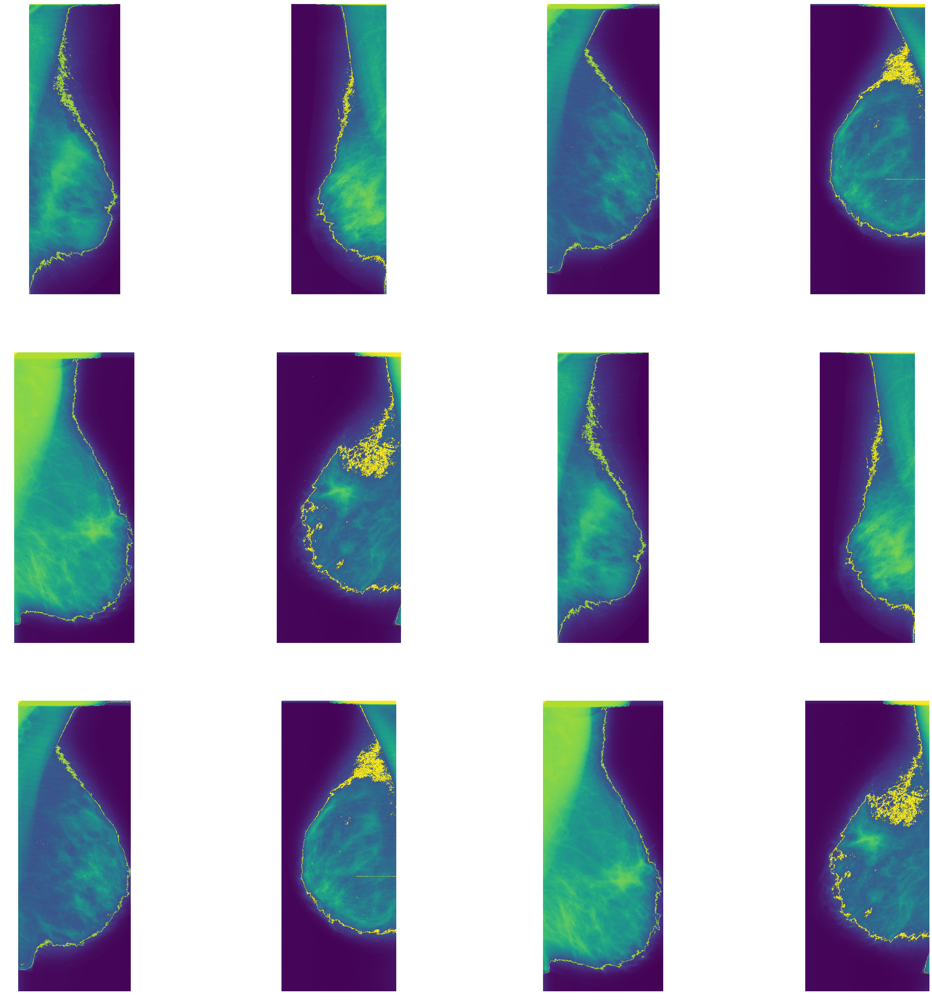

In [64]:
show_images(failed_MLO_images,3,4)

### 3.2. Poszukiwanie linii prostej w obrazie - metoda Canny z OpenCV

Pomysł : brzeg mięśnia zazwyczaj jest linią w miarę prostą (w przeciwieństwie do tkanki gruczołowo-tłuszczowej)

In [65]:
kernel_size = 5
blur_gray = cv2.GaussianBlur(all_rois[1],(kernel_size, kernel_size),0)

In [66]:
low_threshold = 1
high_threshold = 30
edges = cv2.Canny(blur_gray, low_threshold, high_threshold)

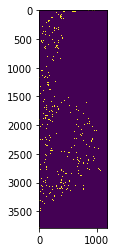

In [67]:
plt.imshow(edges)

In [68]:
rho = 1  # distance resolution in pixels of the Hough grid
theta = np.pi / 180  # angular resolution in radians of the Hough grid
threshold = 15  # minimum number of votes (intersections in Hough grid cell)
min_line_length = 50  # minimum number of pixels making up a line
max_line_gap = 20  # maximum gap in pixels between connectable line segments
line_image = np.copy(all_rois[1]) * 0  # creating a blank to draw lines on

# Run Hough on edge detected image
# Output "lines" is an array containing endpoints of detected line segments
## lines = cv2.HoughLinesP(edges, rho, theta, threshold, np.array([]),
   #                 min_line_length, max_line_gap)

lines = cv2.HoughLinesP(edges, 1, np.pi/2, 2, None, 30, 1);

for line in lines:
    for x1,y1,x2,y2 in line:
        print((x1,y1),(x2,y2))
        cv2.line(line_image,(x1,y1),(x2,y2),(255, 0, 255),500)

(2, 3771) (2, 3682)
(791, 11) (833, 11)
(1003, 7) (1034, 7)


In [70]:
# Draw the lines on the  image
lines_edges = cv2.addWeighted(all_rois[1], 0.8, line_image, 0.3, 0)

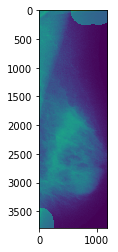

In [71]:
plt.imshow(lines_edges)

### 3.3. Poszukiwanie linii prostej w obrazie - próba znalezienia pionowych konturów

In [72]:
original = all_rois[1].copy()
thresh = cv2.threshold(original, 40, 255, cv2.THRESH_BINARY_INV + cv2.THRESH_OTSU)[1]

In [73]:
kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (5,5))
close = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel, iterations=2)

In [74]:
# Find vertical lines
vertical_kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (2,35))
detect_vertical = cv2.morphologyEx(close, cv2.MORPH_OPEN, vertical_kernel, iterations=2)
cnts = cv2.findContours(detect_vertical, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]
for c in cnts:
    cv2.drawContours(original, [c], -1, (36,255,12), -1)

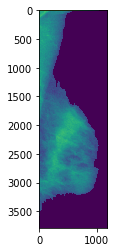

In [75]:
plt.imshow(original)

### 3. Udana próba: znalezienie największego konturu wewnątrz wcześniej wybranego ROI

1. Największym "jednolitym" obszarem w wybranym wcześniej obrazie jest obszar mięśnia
2. Na w ten sposób wyciętym fragmencie można wyznaczyć kontur na podstawie progu jasności
3. Na obszar mięśnia oddzielonego konturem można nałożyć maskę
4. Ten sam kontur można nałożyć na obraz pełnego ROI

In [176]:
img = all_rois[1].copy()

In [177]:
threshold = 120

In [178]:
_, binary_img = cv2.threshold(img, threshold, 255, cv2.THRESH_BINARY_INV)
inverted_img = 255 - binary_img
cropped_img = inverted_img[0:inverted_img.shape[0]-0, 0:inverted_img.shape[1]]

# find contours
cnts = cv2.findContours(cropped_img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
cnts = cnts[0] if len(cnts) == 2 else cnts[1]

# find biggest object on image
mx = (0,0,0,0)      # biggest bounding box so far
mx_area = 0
for cont in cnts:
    x,y,w,h = cv2.boundingRect(cont)
    area = w*h
    if area > mx_area:
        mx = x,y,w,h
        mx_area = area
x,y,w,h = mx

# Output
roi = img[y:y+h,x:x+w]
binary_roi = cropped_img[y:y+h,x:x+w]

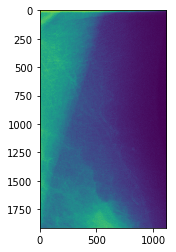

In [179]:
plt.imshow(roi)

In [180]:
kernel_dilation = np.ones((5,5), np.uint8)
dilation = cv2.dilate(roi, kernel_dilation, iterations=12)
ret, thresh = cv2.threshold(dilation, 127, 255, 0)

In [181]:
contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

cnt = contours[0]
max_area = cv2.contourArea(cnt)

for cont in contours:
    if cv2.contourArea(cont) > max_area:
        cnt = cont
        max_area = cv2.contourArea(cont)

cv2.drawContours(roi, [cnt], 0, (255,0,255), 3)

array([[255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       [255, 255, 255, ..., 255, 255, 255],
       ...,
       [255, 255, 255, ...,  24,  25,  26],
       [255, 255, 255, ...,  24,  27,  24],
       [255, 255, 255, ...,  26,  27,  27]], dtype=uint8)

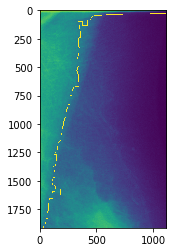

In [182]:
plt.imshow(roi)

In [183]:
mask = np.zeros_like(roi) # Create mask where white is what we want, black otherwise
cv2.drawContours(mask, [cnt], 0, 255, -1) # Draw filled contour in mask
out = np.zeros_like(roi) # Extract out the object and place into output image
mask = 255 - mask
out[mask == 255] = roi[mask == 255]

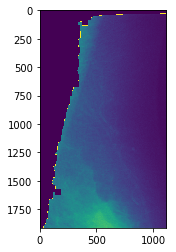

In [184]:
plt.imshow(out)

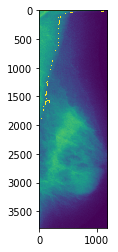

In [185]:
plt.imshow(img)

In [186]:
mask = np.zeros_like(img) # Create mask where white is what we want, black otherwise
cv2.drawContours(mask, [cnt], 0, 255, -1) # Draw filled contour in mask
out = np.zeros_like(img) # Extract out the object and place into output image
mask = 255 - mask
out[mask == 255] = img[mask == 255]

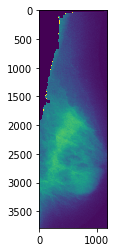

In [187]:
plt.imshow(out)

In [171]:
# jedna funkcja

def remove_muscle(img):
    
    threshold = 120
    _, binary_img = cv2.threshold(img, threshold, 255, cv2.THRESH_BINARY_INV)
    inverted_img = 255 - binary_img
    cropped_img = inverted_img[0:inverted_img.shape[0]-0, 0:inverted_img.shape[1]]

    # find contours
    cnts = cv2.findContours(cropped_img, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
    cnts = cnts[0] if len(cnts) == 2 else cnts[1]

    # find biggest object on image
    mx = (0,0,0,0)      # biggest bounding box so far
    mx_area = 0
    for cont in cnts:
        x,y,w,h = cv2.boundingRect(cont)
        area = w*h
        if area > mx_area:
            mx = x,y,w,h
            mx_area = area
    x,y,w,h = mx

    # smaller roi - muscle
    roi = img[y:y+h,x:x+w]
    
    kernel_dilation = np.ones((5,5), np.uint8)
    dilation = cv2.dilate(roi, kernel_dilation, iterations=12)
    ret, thresh = cv2.threshold(dilation, 127, 255, 0)
    
    contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

    cnt = contours[0]
    max_area = cv2.contourArea(cnt)

    for cont in contours:
        if cv2.contourArea(cont) > max_area:
            cnt = cont
            max_area = cv2.contourArea(cont)

    cv2.drawContours(roi, [cnt], 0, (255,0,255), 3)
    
    mask = np.zeros_like(img) # Create mask where white is what we want, black otherwise
    cv2.drawContours(mask, [cnt], 0, 255, -1) # Draw filled contour in mask
    out = np.zeros_like(img) # Extract out the object and place into output image
    mask = 255 - mask
    out[mask == 255] = img[mask == 255]
    
    return out

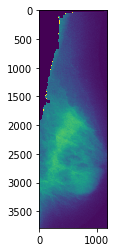

In [188]:
MLO_1 = all_rois[1].copy()
final = remove_muscle(MLO_1)
plt.imshow(final)

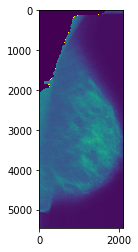

In [193]:
MLO_1 = all_rois[5].copy()
final = remove_muscle(MLO_1)
plt.imshow(final)

### 4. Nałożenie maski na tło dookoła

1. Znalezienie konturu na podstawie progu
2. Nałożenie maski na tło oddzielone konturem

In [164]:
new_out = out.copy()

In [168]:
def contour_background(raw_img):
    img = raw_img.copy()
    kernel_dilation = np.ones((5,5), np.uint8)
    dilation = cv2.dilate(img, kernel_dilation, iterations=12)
    ret, thresh = cv2.threshold(dilation, 30, 255, 0)

    contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_NONE)

    cnt = contours[0]
    max_area = cv2.contourArea(cnt)

    for cont in contours:
        if cv2.contourArea(cont) > max_area:
            cnt = cont
            max_area = cv2.contourArea(cont)

    cv2.drawContours(img, [cnt], 0, (255,0,255), 3)
    
    mask = np.zeros_like(img) # Create mask where white is what we want, black otherwise
    cv2.drawContours(mask, [cnt], 0, 255, -1) # Draw filled contour in mask
    final_out = np.zeros_like(img) # Extract out the object and place into output image
    # mask = 255 - mask
    final_out[mask == 255] = img[mask == 255]
    return final_out

In [169]:
f = contour_background(new_out)

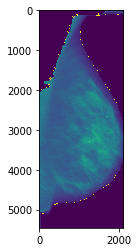

In [170]:
plt.imshow(f)

## Zastosowanie metody do wszystkich obrazów

In [195]:
for image in all_images_with_info:
    
    if image.projection == "CC":
        
        # wystarczy dodać maskę na tło wokół konturu
        image.final_ROI = contour_background(image.first_ROI)
    
    if image.projection == "MLO":
        
        # najpierw usunięcie mięśnia
        no_muscle_mlo = remove_muscle(image.first_ROI)
        
        # później dodanie maski wokół konturu
        image.final_ROI = contour_background(no_muscle_mlo)

In [207]:
all_final_images = []

for elem in all_images_with_info:
    all_final_images.append(elem.final_ROI)
    cv2.imwrite(r'sample_images\results\final_'+str(elem.img_id)+".png", elem.final_ROI)

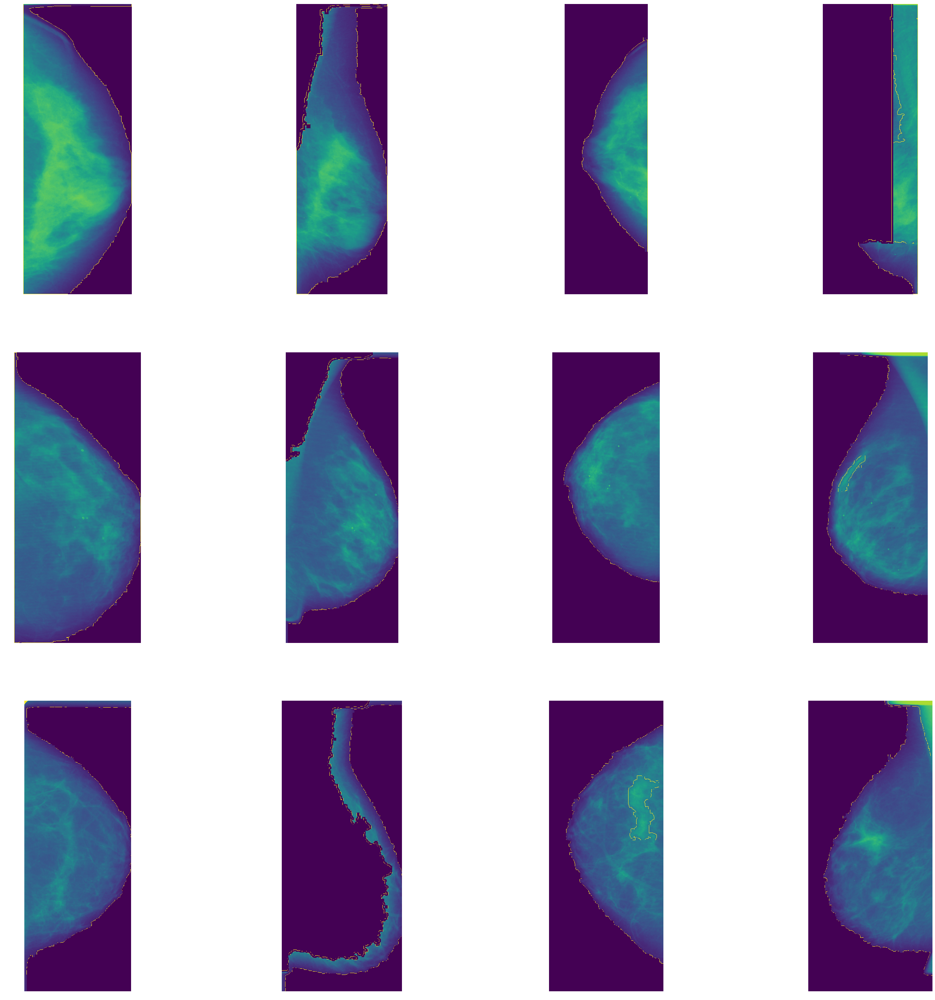

In [199]:
show_images(all_final_images, 3, 4)